# Task1

In [1]:
import numpy as np
import re
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm
from scipy import sparse


In [2]:
def text_preprocessing(file_name):
    vocab = dict()
    with open(file_name, 'r') as f: 
        lines = [re.sub(u"([^\u0061-\u007a\u0030-\u0039\u0020])", "", line.strip('\n').lower()) for line in f]
        for line in lines:
            line = line.split(' ')
            line.remove('') if '' in line else line
            for word in line:
                if word in vocab:
                    vocab[word] += 1
                else:
                    vocab[word] = 1
    del vocab['']
    vocab = sorted(vocab.items(), key = lambda item: item[1], reverse=True)
    return vocab

def gen_zipf_dist(n):
    zipf_dist = np.zeros(n)
    denum = sum([1/i for i in range(1, n+1)])
    for i in range(1, n+1):
        zipf_dist[i-1] = 1/(i*denum)
    return zipf_dist

def plot1(freq_list, zipf_dist):
    plt.plot(np.arange(len(freq_list)), freq_list, label='data')
    plt.plot(np.arange(len(freq_list)), zipf_dist, '--', label="theory (Zipf's law)")
    plt.grid()
    plt.legend()
    plt.xlabel('Term frequency ranking')
    plt.ylabel('Term prob. of occurrence')
    plt.title("Plot of Zipf's law distribution and empr distribution")
    plt.savefig('D1_0.png', dpi=500)
    plt.show()

def plot2(freq_list, zipf_dist):
    plt.loglog(np.arange(1, len(freq_list)+1), freq_list, label='data') 
    plt.loglog(np.arange(1, len(freq_list)+1), zipf_dist, '--', label="theory (Zipf's law)")
    plt.xlim(left=1)
    plt.grid()
    plt.legend()
    plt.xlabel('Term frequency ranking (log)')
    plt.ylabel('Term prob. of occurrence (log)')
    plt.title("Log-Log plot of Zipf's law distribution and empr distribution")
    plt.savefig('D1_1.png', dpi=500)
    plt.show()

In [3]:
vocab = text_preprocessing('coursework-1-data/passage-collection.txt')
freq_list = np.array(vocab)[:, 1]
freq_list = freq_list.astype(np.int64)
freq_list = freq_list / sum(freq_list)
zipf_dist = gen_zipf_dist(len(freq_list))

In [4]:
zipf_dist

array([7.80011931e-02, 3.90005966e-02, 2.60003977e-02, ...,
       3.75833292e-07, 3.75831481e-07, 3.75829670e-07])

In [5]:
freq_list

array([6.02904634e-02, 3.22972482e-02, 2.71202616e-02, ...,
       9.68656879e-08, 9.68656879e-08, 9.68656879e-08])

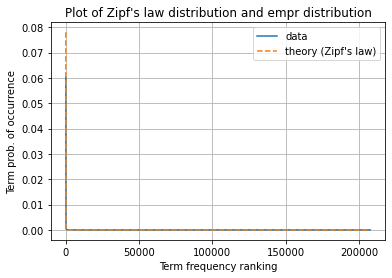

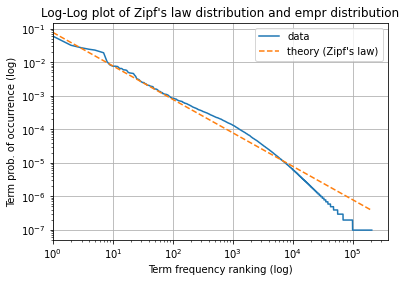

In [6]:
plot1(freq_list, zipf_dist)
plt.clf()
plot2(freq_list, zipf_dist)

In [7]:
len(vocab)

207544

# Task2

In [8]:
# read passage
whole_passage = []
with open('coursework-1-data/candidate-passages-top1000.tsv', 'r') as f: 
    for line in f.readlines():
        line = line.strip('\n').lower().split('\t')
        line[0] = int(line[0])
        line[1] = int(line[1])
        line[2] = re.sub(u"([^/u0061-\u007a\u0030-\u0039\u0020])", "", line[2])
        line[3] = re.sub(u"([^\u0061-\u007a\u0030-\u0039\u0020])", "", line[3])
        whole_passage.append(line)

    

In [9]:
#remove redundant passages, sort them with pid

#uni_passage is in order with rank_pid
whole_passage = np.array(whole_passage)

pid = whole_passage[:, 1].astype(np.int64)

rank_pid, idx_p = np.unique(pid, return_index=True)

whole_passage_p = whole_passage[idx_p]

uni_passage = whole_passage_p[:, -1]


In [10]:
# query[np.where(qid == 1108939)], uni_passage[np.where(rank_pid == 4390191)]

In [11]:
np.where(rank_pid == 7130104)

(array([147268]),)

In [12]:
# remove stop words in vocab
num_stop_words = 20
new_vocab = np.array(np.array(vocab)[num_stop_words: ])[:, 0]
new_vocab_dict = {}

for i, word in enumerate(new_vocab):
    new_vocab_dict[word] = i

In [13]:
line = uni_passage[0].split(' ')
line_vocab = {}
for word in line:
    if word in line_vocab:
        line_vocab[word] += 1
    else:
        line_vocab[word] = 1

temp = np.zeros(207524)
#record the frequency 
for word in line:
    if word in new_vocab_dict:
        temp[new_vocab_dict[word]] = line_vocab[word]

In [14]:
len(new_vocab_dict)

207524

In [15]:
#construct inverted_idx matrix
row,col,data = [],[],[]
Ld = []
for i, line in enumerate(tqdm(uni_passage)):
    line = line.split(' ')
    line.remove('') if '' in line else line
    Ld.append(len(line))

    line_vocab = {}
        
    for word in line:
        #column is in order with the frequency of word in vocabulary
        if word in new_vocab_dict:
            row.append(i)
            col.append(new_vocab_dict[word])
            data.append(1)

inverted_idx = sparse.csr_matrix((data, (row, col)), shape=(len(uni_passage), len(new_vocab_dict)))


100%|██████████| 182469/182469 [00:03<00:00, 55712.00it/s]


In [16]:
# uni_passage[np.where(rank_pid == 301)]

In [17]:
## construct inverted_idx_dict from inverted_idx_matrix
inverted_idx_dict = {}
for word in new_vocab:
    inverted_idx_dict[word] = {}


for i in tqdm(range(inverted_idx.shape[0])):
    passage = inverted_idx[i].toarray()
    nonzero_idx = np.nonzero(passage)
    for j, word in enumerate(new_vocab[nonzero_idx[1]]):
        inverted_idx_dict[word][rank_pid[i]] = passage[nonzero_idx][j]


100%|██████████| 182469/182469 [01:56<00:00, 1566.61it/s]


In [18]:
inverted_idx_dict

{'can': {698: 3,
  860: 1,
  1353: 1,
  1890: 1,
  1971: 2,
  2140: 1,
  2218: 1,
  2354: 2,
  2357: 1,
  2362: 3,
  2725: 1,
  2880: 1,
  4252: 2,
  4642: 2,
  4643: 1,
  4646: 2,
  4648: 1,
  4649: 3,
  4651: 1,
  5410: 1,
  5416: 1,
  5418: 1,
  5482: 1,
  5486: 1,
  6053: 2,
  6070: 1,
  6142: 1,
  6191: 1,
  6956: 1,
  8424: 2,
  8428: 1,
  9539: 1,
  10179: 1,
  10595: 1,
  10979: 1,
  10989: 1,
  11114: 1,
  11620: 1,
  11778: 1,
  11794: 3,
  11843: 1,
  11937: 2,
  11938: 1,
  12078: 1,
  12360: 1,
  12362: 2,
  12555: 1,
  12740: 1,
  13489: 2,
  13492: 3,
  13499: 1,
  13975: 1,
  14165: 1,
  14268: 1,
  14273: 2,
  14616: 2,
  14618: 2,
  14622: 2,
  14784: 3,
  15090: 1,
  15799: 1,
  15800: 2,
  15801: 2,
  15805: 2,
  15806: 2,
  16776: 3,
  16779: 1,
  16889: 1,
  17980: 1,
  18082: 1,
  19028: 1,
  19290: 1,
  19555: 1,
  19637: 1,
  20759: 1,
  20999: 1,
  21006: 1,
  22208: 4,
  22213: 1,
  22283: 2,
  22451: 1,
  22453: 1,
  22756: 1,
  23586: 1,
  24585: 1,
  25367

# Task3


In [19]:
# #calculate idf and idf_bm25 of new_vocab 
num_passage = inverted_idx.shape[0]
num_vocab = inverted_idx.shape[1]
idf = np.zeros(num_vocab)
idf_bm25 = np.zeros(num_vocab)
block = 1000

for i in tqdm(range(0, (num_vocab // block)*block, block)):
    temp = inverted_idx[:, i:i+block].toarray()  
    count_zero_temp = np.count_nonzero(temp, axis=0) 
    idf[i:i+block] = np.log10(num_passage / count_zero_temp)
    idf_bm25[i:i+block] = np.log(((num_passage - count_zero_temp) + 0.5)/ (count_zero_temp + 0.5))
    

temp = inverted_idx[:, i+block:].toarray()
idf[i+block:] = np.log10(num_passage / np.count_nonzero(temp, axis=0))
idf_bm25[i+block:] =  np.log((num_passage - np.count_nonzero(temp, axis=0) + 0.5)/ (np.count_nonzero(temp, axis=0) + 0.5))

 

100%|██████████| 207/207 [01:14<00:00,  2.78it/s]


In [20]:
idf.shape

(207524,)

In [21]:
#construct tfidf doc
data = []
row = []
col = []

for i in tqdm(range((inverted_idx.shape[0]))):
    passage = inverted_idx[i].toarray()[0]
    nonzero_idx = np.nonzero(passage)[0]
    #calculate frequency of word in one single passage
    passage = passage / sum(passage[nonzero_idx])
    #tf*idf
    nonzero_item = passage[nonzero_idx] * idf[nonzero_idx]
    data.extend(nonzero_item)
    row.extend([i for _ in range(len(nonzero_idx))])
    col.extend(nonzero_idx)

tf_idf_doc = sparse.csr_matrix((data, (row, col)), shape=(inverted_idx.shape))


100%|██████████| 182469/182469 [01:20<00:00, 2273.83it/s]


In [22]:
tf_idf_doc.shape

(182469, 207524)

In [23]:
whole_query = []
with open('coursework-1-data/test-queries.tsv', 'r') as f: 
    for line in f.readlines():
        line = line.strip('\n').lower().split('\t')
        line[0] = int(line[0])
        line[1] = re.sub(u"([^\u0061-\u007a\u0030-\u0039\u0020])", "", line[1])
        whole_query.append(line)

whole_query = np.array(whole_query)
qid = whole_query[:, 0].astype(np.int64)
query = whole_query[:, 1]

In [24]:
qid_top1000 = []

pid_top1000 = whole_passage[:, 1].astype(np.int64)
for single_qid in tqdm(qid):
    idx = np.where(single_qid == whole_passage[:, 0].astype(np.int64))[0]
    qid_top1000.append(pid_top1000[idx])


100%|██████████| 200/200 [01:28<00:00,  2.25it/s]


In [25]:
def cal_score_tfidf(query, tf_idf_doc, idf, inverted_idx, new_vocab_dict, rank_pid, qid, qid_top1000):
    res_score = []
    res_pid = []
    res_qid = []
    for i, line in enumerate(tqdm(query)):
        line = line.split(' ')
        line.remove('') if '' in line else line

        temp = np.zeros(inverted_idx.shape[1])

        line_vocab = {}

        #construct small dictionary for one single query
        for word in line:
            if word in line_vocab:
                line_vocab[word] += 1
            else:
                line_vocab[word] = 1

        #record the frequency 
        for word in line:
            if word in new_vocab_dict:
                temp[new_vocab_dict[word]] = line_vocab[word]

        #calculate the tf for one single query
        tf_q = temp / np.sum(temp)
        if np.sum(temp) == 0:
            print('Too many stop words have been deleted, please change the number of it.')

        #calculate tf_idf for one single query
        tf_idf_q = tf_q * idf

        #take out words in query (those elements have non-zero value in tf_q)
        nonzero_idx = np.nonzero(tf_q)[0]
        tf_idf_q_nz = tf_idf_q[nonzero_idx]

        #take out passages-sub-matrix in corresponding position
        p_tf_idf_doc_nz = tf_idf_doc[:, nonzero_idx].toarray() 

        #take out corresponding 1000 passages
        candidate_idx = np.zeros(qid_top1000[i].shape[0])
        for p, candidate in enumerate(qid_top1000[i]):
            cur_idx = np.where(rank_pid == candidate)[0]
            candidate_idx[p] = cur_idx
        candidate_idx = candidate_idx.astype(np.int64)

        p_tf_idf_doc = tf_idf_doc[candidate_idx, :].toarray() 
        p_tf_idf_doc_nz = p_tf_idf_doc_nz[candidate_idx]

        temp_rank_pid = qid_top1000[i]

        #calculate score, take out corresponding top 100 pid
        temp_norm = np.linalg.norm(tf_idf_q) * np.linalg.norm(p_tf_idf_doc, axis=1)
        nonzero_norm_idx = np.nonzero(temp_norm)[0]
        nonzero_norm = temp_norm[nonzero_norm_idx]

        temp_score = np.zeros(len(qid_top1000[i]))
        temp_score[nonzero_norm_idx] = np.sum(tf_idf_q_nz * p_tf_idf_doc_nz[nonzero_norm_idx], axis=1) / nonzero_norm

        temp_res_pid = temp_rank_pid[np.argsort(temp_score)[::-1][:100]]
        temp_res_score = temp_score[np.argsort(temp_score)[::-1][:100]]


        #save pid, save score, save qid
        res_score.extend(temp_res_score)
        temp_len = 100 if len(p_tf_idf_doc_nz) >= 100 else len(p_tf_idf_doc_nz)
        res_qid.extend([qid[i] for _ in range(temp_len)])
        res_pid.extend(temp_res_pid)

        
    #write into csv file
    data = {'qid': res_qid, 'pid': res_pid, 'score': res_score}
    data_df = pd.DataFrame(data)
    data_df.to_csv('tfidf.csv',index=False,header=False)

        


In [26]:
cal_score_tfidf(query, tf_idf_doc, idf, inverted_idx, new_vocab_dict, rank_pid, qid, qid_top1000)

100%|██████████| 200/200 [01:36<00:00,  2.06it/s]


In [27]:
def cal_score_bm25(query, tf_idf_doc, idf_bm25, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, qid_top1000):
    #hyperparameters for BM25
    k1 = 1.2
    k2 = 100
    b = 0.75

    #initialize store box
    res_score = []
    res_pid = []
    res_qid = []

    # deal with one query at a time
    for i, line in enumerate(tqdm(query)):
        line = line.split(' ')
        line.remove('') if '' in line else line

        temp = np.zeros(inverted_idx.shape[1])

        line_vocab = {}

        #construct small dictionary for one single query
        for word in line:
            if word in line_vocab:
                line_vocab[word] += 1
            else:
                line_vocab[word] = 1

        #record the frequency 
        for word in line:
            if word in new_vocab_dict:
                temp[new_vocab_dict[word]] = line_vocab[word]

        #calculate the tf for one single query
        tf_q = temp
        if np.sum(temp) == 0:
            print('Too many stop words have been deleted, please change the number of it.')

        #take out words in query (those elements have non-zero value in tf_q)
        nonzero_idx = np.nonzero(tf_q)[0]
        tf_q = tf_q[nonzero_idx]

        #take out passages-sub-matrix in corresponding position
        p_idf = idf_bm25[nonzero_idx].reshape(1, -1)
        
        p_tf_doc = inverted_idx[:, nonzero_idx].toarray()

        #take out corresponding 1000 passages
        candidate_idx = np.zeros(qid_top1000[i].shape[0])
        for p, candidate in enumerate(qid_top1000[i]):
            cur_idx = np.where(rank_pid == candidate)[0]
            candidate_idx[p] = cur_idx
        candidate_idx = candidate_idx.astype(np.int64)
        p_tf_doc = p_tf_doc[candidate_idx]

        temp_rank_pid = qid_top1000[i]

        L = (Ld/np.mean(Ld))[candidate_idx].reshape(-1, 1)
        
        #calculate score, take out corresponding top 100 pid
        nonzero_p_idx = np.nonzero(np.sum(p_tf_doc, axis=1))[0]

        temp_score = np.zeros(len(qid_top1000[i]))
        temp_score[nonzero_p_idx] = np.sum(p_idf * (k1 + 1) * p_tf_doc[nonzero_p_idx] * (k2 + 1) * tf_q / ((k1*((1-b) + b*(L[nonzero_p_idx])) + p_tf_doc[nonzero_p_idx]) * (k2 + tf_q)), axis=1)
        temp_res_pid = temp_rank_pid[np.argsort(temp_score)[::-1][:100]]
        temp_res_score = temp_score[np.argsort(temp_score)[::-1][:100]]


        #save pid, save score, save qid
        res_score.extend(temp_res_score)
        temp_len = 100 if len(p_tf_doc) >= 100 else len(p_tf_doc)
        res_qid.extend([qid[i] for _ in range(temp_len)])
        res_pid.extend(temp_res_pid)


        
    #write into csv file
    data = {'qid': res_qid, 'pid': res_pid, 'score': res_score}
    data_df = pd.DataFrame(data)
    data_df.to_csv('bm25.csv',index=False,header=False)




In [28]:
cal_score_bm25(query, tf_idf_doc, idf_bm25, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, qid_top1000)

100%|██████████| 200/200 [00:23<00:00,  8.44it/s]


# Task4

In [29]:
whole_query = []
with open('coursework-1-data/test-queries.tsv', 'r') as f: 
    for line in f.readlines():
        line = line.strip('\n').split('\t')
        line[0] = int(line[0])
        line[1] = re.sub(u"([^\u0041-\u005a\u0061-\u007a\u0030-\u0039\u0020])", "", line[1])
        whole_query.append(line)

whole_query = np.array(whole_query)
qid = whole_query[:, 0].astype(np.int64)
query = whole_query[:, 1]

In [30]:
def language_model(query, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, mode='laplace'):

    res_score = []
    res_pid = []
    res_qid = []

    for i, line in enumerate(tqdm(query)):
        line = line.split(' ')
        line.remove('') if '' in line else line

        temp = np.zeros(inverted_idx.shape[1]) 

        line_vocab = {}

        #construct small dictionary for one single query
        for word in line:
            if word in line_vocab:
                line_vocab[word] += 1
            else:
                line_vocab[word] = 1

        #record the frequency 
        for word in line:
            if word in new_vocab_dict:
                temp[new_vocab_dict[word]] = line_vocab[word]

        #calculate the tf for one single query
        freq_q = temp 
        if np.sum(temp) == 0:
            print('Too many stop words have been deleted, please change the number of it.')

        #take out words in query (those elements have non-zero value in tf_q)
        nonzero_idx = np.nonzero(freq_q)[0] 
        freq_q = freq_q[nonzero_idx] 

        #take out corresponding 1000 passages
        candidate_idx = np.zeros(qid_top1000[i].shape[0])
        for p, candidate in enumerate(qid_top1000[i]):
            cur_idx = np.where(rank_pid == candidate)[0]
            candidate_idx[p] = cur_idx
        candidate_idx = candidate_idx.astype(np.int64)

        temp_rank_pid = qid_top1000[i]

        #calculate score
        if mode == 'laplace':
            #take out passage-sub-matrix in corresponding position for laplace
            q_laplace_prob = np.log((inverted_idx[:, nonzero_idx].toarray() + 1) / (len(new_vocab_dict) + np.array(Ld)).reshape(-1, 1))
            temp_score = np.sum(freq_q * q_laplace_prob[candidate_idx], axis=1) 
        else:
            epsilon = 0.1
            #take out passage-sub-matrix in corresponding position for lindstone
            q_lindstone_prob =  np.log((inverted_idx[:, nonzero_idx].toarray() + epsilon) / (len(new_vocab_dict)*epsilon + np.array(Ld)).reshape(-1, 1))
            temp_score = np.sum(freq_q * q_lindstone_prob[candidate_idx], axis=1)

        temp_res_pid = temp_rank_pid[np.argsort(temp_score)[::-1][:100]]
        temp_res_score = temp_score[np.argsort(temp_score)[::-1][:100]]

        #save pid, save score, save qid
        res_score.extend(temp_res_score)
        res_qid.extend([qid[i] for _ in range(len(temp_res_pid))])
        res_pid.extend(temp_res_pid)

        
    #write into csv file
    data = {'qid': res_qid, 'pid': res_pid, 'score': res_score}
    data_df = pd.DataFrame(data)
    data_df.to_csv(mode+'.csv',index=False,header=False)


    

In [31]:
language_model(query, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, mode='laplace')

100%|██████████| 200/200 [00:23<00:00,  8.58it/s]


In [32]:
language_model(query, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, mode='lidstone')

100%|██████████| 200/200 [00:23<00:00,  8.58it/s]


In [33]:
# remove stop words in vocab
num_stop_words = 20
vocab_for_dirichlet = np.array(np.array(vocab)[num_stop_words: ])
vocab_for_dirichlet = vocab_for_dirichlet[:, 1].astype(np.int64)
vocab_for_dirichlet = vocab_for_dirichlet / np.sum(vocab_for_dirichlet)

In [34]:
def dirichlet(query, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, vocab_for_dirichlet):

    res_score = []
    res_pid = []
    res_qid = []

    for i, line in enumerate(tqdm(query)):
        line = line.split(' ')
        line.remove('') if '' in line else line

        temp = np.zeros(inverted_idx.shape[1])

        line_vocab = {}

        #construct small dictionary for one single query
        for word in line:
            if word in line_vocab:
                line_vocab[word] += 1
            else:
                line_vocab[word] = 1

        #record the frequency 
        for word in line:
            if word in new_vocab_dict:
                temp[new_vocab_dict[word]] = line_vocab[word]

        #calculate the tf for one single query
        freq_q = temp
        if np.sum(temp) == 0:
            print('Too many stop words have been deleted, please change the number of it.')

        #take out words in query (those elements have non-zero value in tf_q)
        nonzero_idx = np.nonzero(freq_q)[0]
        freq_q = freq_q[nonzero_idx]

        #take out corresponding 1000 passages
        candidate_idx = np.zeros(qid_top1000[i].shape[0])
        for p, candidate in enumerate(qid_top1000[i]):
            cur_idx = np.where(rank_pid == candidate)[0]
            candidate_idx[p] = cur_idx
        candidate_idx = candidate_idx.astype(np.int64)

        temp_rank_pid = qid_top1000[i]

        mu = 50
        lam = (np.array(Ld)/(np.array(Ld) + mu)).reshape(-1, 1) # (num_passage, 1)
        q_dirichlet_prob = lam * (inverted_idx[:, nonzero_idx].toarray() / np.array(Ld).reshape(-1, 1)) + (1 - lam) * vocab_for_dirichlet[nonzero_idx].reshape(1, -1) 

        temp_score = np.sum(np.log(q_dirichlet_prob[candidate_idx]) * freq_q, axis=1)

        temp_res_pid = temp_rank_pid[np.argsort(temp_score)[::-1][:100]]
        temp_res_score = temp_score[np.argsort(temp_score)[::-1][:100]]

        #save pid, save score, save qid
        res_score.extend(temp_res_score)
        res_qid.extend([qid[i] for _ in range(len(temp_res_pid))])
        res_pid.extend(temp_res_pid)

        
    #write into csv file
    data = {'qid': res_qid, 'pid': res_pid, 'score': res_score}
    data_df = pd.DataFrame(data)
    data_df.to_csv('dirichlet.csv',index=False,header=False)

    


In [35]:
dirichlet(query, inverted_idx, new_vocab_dict, rank_pid, qid, Ld, vocab_for_dirichlet)

100%|██████████| 200/200 [00:25<00:00,  7.77it/s]
